Seeing how to unstabilize the eigth: $\mu = 19 + sin(2 \pi t)$

In [30]:
using DifferentialEquations
using Random
using LaTeXStrings

In [2]:
include("solvers.jl")
include("UsefulFunctions.jl")
include("PlotFunctions.jl")

PlotPipPlot (generic function with 1 method)

In [3]:
# initial conditions
x₀=[3.98351;
   6.02511;
   7.94995]
t₀ = 10
θ = 10; β = 8/3
t = 70
ϵ = 4
Δt = 0.0002 #as small as smallest dt we tested with

0.0002

In [4]:
function P8(t)
    return [θ, 19+5*sin(2*pi*(t+t₀)), β]
end

P8 (generic function with 1 method)

In [63]:
function P_Pert(t)
    return [θ, 19+5*sin(2*pi*(t+t₀)) + ϵ*(t-t₀)^2, β]
end

P_Pert (generic function with 1 method)

In [64]:
function perturbation(t)
    return sin(t)^2
end

perturbation (generic function with 1 method)

In [65]:
X_O = lorenz_solution_fixed_timestep(P8, Δt, Integer(t/Δt), x₀, RK4) 
X_P = lorenz_solution_fixed_timestep(P_Pert, Δt, Integer(t/Δt), x₀, RK4) 

3×350001 Matrix{Float64}:
 3.98351  3.9876   3.99169  3.99579  …  3.99369  3.99779  4.0019   4.00602
 6.02511  6.03272  6.04034  6.04797     6.04343  6.05107  6.05871  6.06637
 7.94995  7.95052  7.95109  7.95168     7.95893  7.95952  7.96012  7.96073

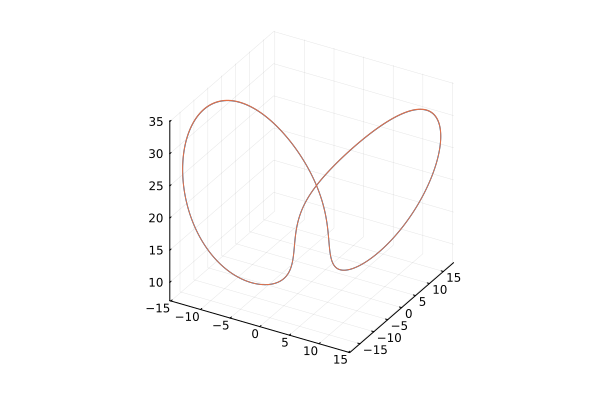

In [66]:
p=plot()
PlotTrajectories(p,[X_O[:,1:end],X_P[:,1:end]])
#savefig("plots/Eight_Sensitivity/eight_expsin_epsilon_minus4.png")

Correlation plots

In [67]:
epsilon_vals=[1 2 3 4 5]
X=lorenz_solution_fixed_timestep(P8, Δt, Integer(t/Δt), x₀, RK4) 
M₁=zeros(3*length(epsilon_vals),Integer(t/Δt)+1)
for i=1:length(epsilon_vals)
    ϵ = 10.0^(-epsilon_vals[i])
    M₁[3*(i-1)+1:3*(i),1:end] = lorenz_solution_fixed_timestep(P_Pert, Δt, Integer(t/Δt), x₀, RK4) 
end

In [68]:
CorrMatrix = correlation_matrix_initpos(M₁[:,1:end], X[:,1:end])

5×350001 Matrix{Float64}:
 1.0  1.0  0.999999  0.999998  0.999997  …  0.620146  0.61926   0.618371
 1.0  1.0  1.0       1.0       1.0          0.624853  0.624317  0.62378
 1.0  1.0  1.0       1.0       1.0          0.999667  0.99966   0.999653
 1.0  1.0  1.0       1.0       1.0          0.99969   0.999691  0.999691
 1.0  1.0  1.0       1.0       1.0          0.999997  0.999997  0.999997

In [70]:
PlotPipPlot(CorrMatrix,Δt,[1:1:5],title="\$ \\textrm{Correlation \\, of \\, \\,} 19 + 5 \\sin(2 \\pi t) \\textrm{\\, vs \\, \\,} 19 + 5 \\sin(2 \\pi t) + \\epsilon t^2 \$",clim=(0.95,1),cmap=:grayC, yaxis=true)
savefig("plots/Eight_Sensitivity/eight_corr_eight_epsilon10tominus1tominus5.png")

"/Users/00eila01/01_Arbete/UTBILDNING/KEXET/Numerical-Solutions-and-Parameter-Sensitivity-of-the-Lorentz-System-Degree-Project-in-Technology/Time-Dep-Parameters/plots/Eight_Sensitivity/eight_corr_eight_epsilon10tominus1tominus5.png"